In [1]:
import json
import pandas as pd
import numpy as np
import re
import requests
import matplotlib.pyplot as plt
import folium
from shapely.geometry import Point
import geopandas as gpd
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [2]:
#violations.csv loaded after being cleaned in phase 1

violations = pd.read_csv('../data/violations.csv')

In [3]:
violations.head()

,date_time_opened,case_number,status,case_subrequest,case_origin,closed_when_created,incident_address,incident_city,incident_council_district,incident_zip_code,latitude,longitude,mapped_location,date_time_closed,contact_type,parent_case
0,2020-11-06 21:51:48,497464,New,COVID-19 Violations,hubNashville Community,False,301 14th Ave N,NASHVILLE,19.0,37203.0,36.159251,-86.793243,"{'latitude': '36.15925116160531', 'longitude':...",NaN,NaN,NaN
1,2020-11-07 05:07:43,497626,New,COVID-19 Violations,hubNashville Community,False,1531 Broadway,NASHVILLE,19.0,37203.0,36.154065,-86.792344,"{'latitude': '36.1540647', 'longitude': '-86.7...",NaN,NaN,NaN
2,2020-11-06 02:05:43,496725,Closed,COVID-19 Violations,hubNashville Community,False,401 Union St,NASHVILLE,19.0,37219.0,36.164800,-86.779929,"{'latitude': '36.16480010000001', 'longitude':...",2020-11-06T14:42:04.000,NaN,NaN
3,2020-11-06 04:19:04,496741,Closed,COVID-19 Violations,hubNashville Community,False,81 Van Buren St,NASHVILLE,19.0,37208.0,36.181791,-86.784818,"{'latitude': '36.181790734428645', 'longitude'...",2020-11-06T14:35:14.000,NaN,NaN
4,2020-11-05 16:18:39,496042,Closed,COVID-19 Violations,Phone,False,3204 Gallatin Pike,NASHVILLE,7.0,37216.0,36.205640,-86.735940,"{'latitude': '36.20564', 'longitude': '-86.735...",2020-11-06T14:38:31.000,NaN,NaN


In [4]:
#dropped rows with empty gps coordinates as they will cause errors later

violations = violations.dropna(subset = ['latitude'])

In [5]:
#Lambda function to create a column that can be used to assign geometry 

violations['geometry'] = violations.apply(lambda x: Point((float(x.longitude), 
                                                          float(x.latitude))), axis = 1)
violations.head()

,date_time_opened,case_number,status,case_subrequest,case_origin,closed_when_created,incident_address,incident_city,incident_council_district,incident_zip_code,latitude,longitude,mapped_location,date_time_closed,contact_type,parent_case,geometry
0,2020-11-06 21:51:48,497464,New,COVID-19 Violations,hubNashville Community,False,301 14th Ave N,NASHVILLE,19.0,37203.0,36.159251,-86.793243,"{'latitude': '36.15925116160531', 'longitude':...",NaN,NaN,NaN,POINT (-86.79324305 36.15925116160531)
1,2020-11-07 05:07:43,497626,New,COVID-19 Violations,hubNashville Community,False,1531 Broadway,NASHVILLE,19.0,37203.0,36.154065,-86.792344,"{'latitude': '36.1540647', 'longitude': '-86.7...",NaN,NaN,NaN,POINT (-86.792344 36.15406470000001)
2,2020-11-06 02:05:43,496725,Closed,COVID-19 Violations,hubNashville Community,False,401 Union St,NASHVILLE,19.0,37219.0,36.164800,-86.779929,"{'latitude': '36.16480010000001', 'longitude':...",2020-11-06T14:42:04.000,NaN,NaN,POINT (-86.7799287 36.16480010000001)
3,2020-11-06 04:19:04,496741,Closed,COVID-19 Violations,hubNashville Community,False,81 Van Buren St,NASHVILLE,19.0,37208.0,36.181791,-86.784818,"{'latitude': '36.181790734428645', 'longitude'...",2020-11-06T14:35:14.000,NaN,NaN,POINT (-86.78481795092623 36.18179073442865)
4,2020-11-05 16:18:39,496042,Closed,COVID-19 Violations,Phone,False,3204 Gallatin Pike,NASHVILLE,7.0,37216.0,36.205640,-86.735940,"{'latitude': '36.20564', 'longitude': '-86.735...",2020-11-06T14:38:31.000,NaN,NaN,POINT (-86.73594 36.20564)


In [6]:
#Exploration to see if the data has clean gps coordinates...it does not

violations.longitude.sort_values()

4629   -118.318279
9515   -104.979529
3874    -97.004120
1815    -96.983184
8146    -94.005701
           ...    
4878    -76.955058
1980     11.249255
1952     11.249255
1951     11.468288
1970     19.209794
Name: longitude, Length: 11398, dtype: float64

In [7]:
#Again, min and maxes are well outside of metro

violations.longitude.describe()

count    11398.000000
mean       -86.719133
std          1.932298
min       -118.318279
25%        -86.799776
50%        -86.772787
75%        -86.704480
max         19.209794
Name: longitude, dtype: float64

In [8]:
#Boundary file for mapping

metro = gpd.read_file('../data/Davidson County Border.geojson')

In [9]:
#Checking to ensure the boundary files coordinate system is in place

metro.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [10]:
#Created a geopandas data frame with a coordinate system matched to the metro boundary file

violations_geo = gpd.GeoDataFrame(violations, crs = metro.crs, geometry = violations['geometry'])

In [11]:
#Verifying the coordination system 

violations_geo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

(35.945865086682986, 36.4275882606404)

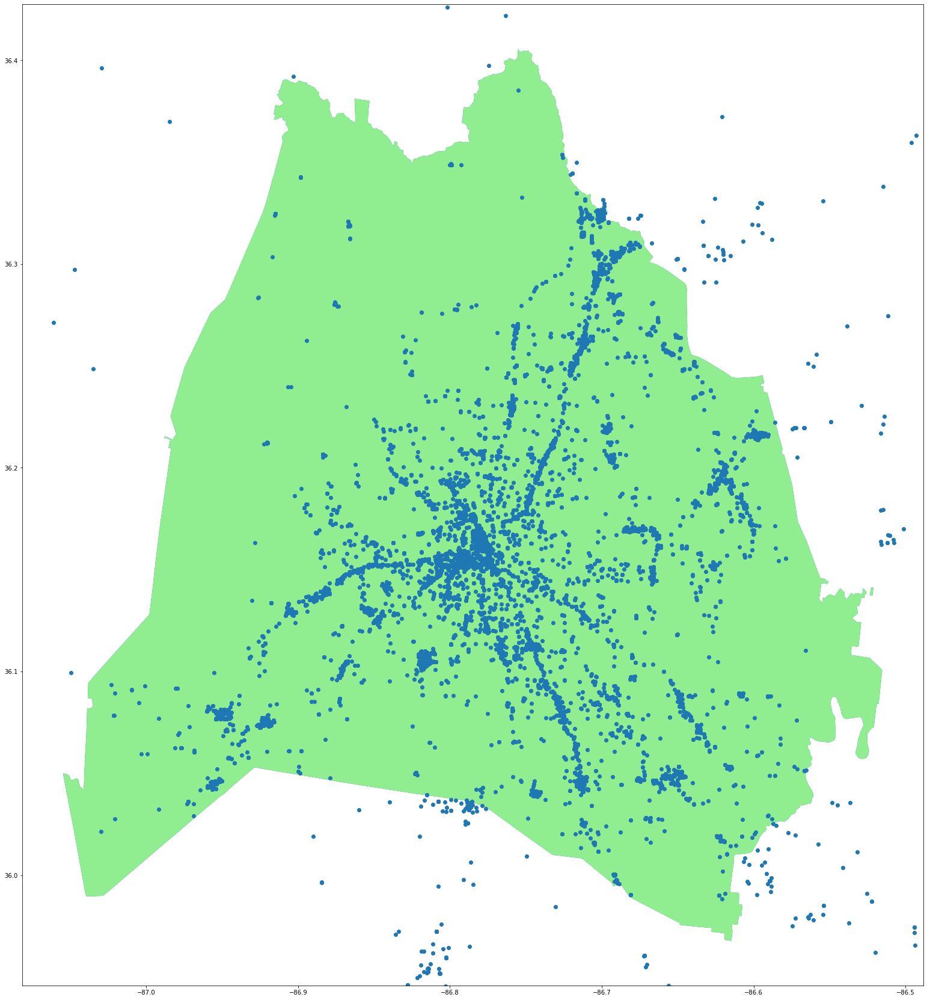

In [12]:
#Basic map plot of the data

ax = metro.plot(figsize = (30,30))

metro.plot(ax = ax, color = 'lightgreen')

xmin, xmax = plt.xlim()
ymin, ymax = plt.ylim()

violations_geo.plot(ax = ax)

plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)

In [13]:
violations_geo.geometry

0        POINT (-86.79324 36.15925)
1        POINT (-86.79234 36.15406)
2        POINT (-86.77993 36.16480)
3        POINT (-86.78482 36.18179)
4        POINT (-86.73594 36.20564)
                    ...            
11643    POINT (-86.80076 36.14702)
11644    POINT (-86.62000 36.19871)
11648    POINT (-86.79741 36.17220)
11665    POINT (-86.94391 36.08447)
11671    POINT (-86.75806 36.22890)
Name: geometry, Length: 11398, dtype: geometry

In [14]:
#Checking to see if the file has multiple centeroids, it does! Normally this would require some sort of checking to see which
#point is actually the centroid. Extra centroids are a result of a non-contiguous, multi-part polygon. If one looks at the map
#displayed in prior, their is a small 'island' just off of the east side of Davidson County. 

metro.geometry.centroid

<ipython-input-14-1873dada2d9a>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  metro.geometry.centroid


0    POINT (-86.78493 36.16952)
1    POINT (-86.52221 36.13925)
dtype: geometry

In [15]:
#Establishing centroid for folium

center = metro.geometry.centroid[0]

<ipython-input-15-b83d810fb703>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  center = metro.geometry.centroid[0]


In [16]:
area_center = [center.y, center.x]

In [17]:
#Creating a map for exploration purposes

map_temp = folium.Map(location = area_center, zoom_start = 10)

In [18]:
#Adds the metro boundary to the folium map

folium.GeoJson(metro).add_to(map_temp)

In [19]:
#Creates the marker clusters

marker_cluster = MarkerCluster().add_to(map_temp)

for row_index, row_values in violations_geo.iterrows():
    loc = [row_values['latitude'], row_values['longitude']]
    pop = folium.Popup(html = str(row_values['incident_address']), min_width = 100, max_width = 250)
    marker = folium.Marker(
    location = loc,
    popup = pop, 
    icon = folium.Icon(color = 'red', icon = 'bullseye', prefix = 'fa'))
    
    marker.add_to(marker_cluster)

In [20]:
#Load's Courtney's fuzzy matched df

top_results = pd.read_csv('../data/top_results.csv')

In [21]:
#map_temp

#Commented out so as not to load on kernal reload

In [22]:
top_results

,Unnamed: 0,violation_coord,violation_address,business_status,name,google_address,google_lat,google_lng,icon,match_ratio,location_type
0,0,"(36.0685457, -86.6838975)","2045 Antioch Pike, Antioch",OPERATIONAL,Los Paisanos,"2045 Antioch Pike, Antioch",36.068546,-86.683898,bar,100,night_club
1,5,"(36.211269429469425, -86.6943024067459)","2800 Opryland Drive, Nashville",OPERATIONAL,Best Buy Express Kiosk,"2800 Opryland Drive, Nashville",36.211414,-86.694149,generic_business,100,point_of_interest
2,10,"(36.1235, -86.79013)","2607 12th Avenue South, Nashville",OPERATIONAL,White Bison Coffee,"2607 12th Avenue South, Nashville",36.123453,-86.790115,cafe,100,convenience_store
3,15,"(36.1941628, -86.8313936)","3200 Clarksville Pike, Nashville",OPERATIONAL,TIGERMARKET #203,"3200 Clarksville Highway, Nashville",36.194220,-86.831207,gas_station,87,gas_station
4,20,"(36.15843971160494, -86.7880380629013)","20 Grundy Street, Nashville",OPERATIONAL,Baldwin Showcase,"Grundy Street, Nashville",36.158366,-86.787996,generic_business,94,point_of_interest
...,...,...,...,...,...,...,...,...,...,...,...
4819,24120,"(36.25852, -86.7583)","3638 Dickerson Pike, Nashville",OPERATIONAL,Mid-Tenn Sheet Metal,"3638 Dickerson Pike, Nashville",36.258571,-86.758322,generic_business,100,general_contractor
4820,24125,"(36.153299711602756, -86.7960281)","1722 West End Avenue, Nashville",OPERATIONAL,Golden Coast,"1722 West End Avenue, Nashville",36.153296,-86.796024,restaurant,100,restaurant
4821,24130,"(36.18837, -86.7676)","1001 Meridian Street, Nashville",OPERATIONAL,North Edgefield Organized,"914 Meridian Street, Nashville",36.188152,-86.768248,generic_business,92,point_of_interest
4822,24135,"(36.1458305, -86.8167581)","221 31st Avenue North, Nashville",OPERATIONAL,31st Ave N & Burch Ave NB,United States,36.146209,-86.816324,generic_business,27,transit_station


In [23]:
#A repeat of the steps completed for map_temp and violations_geo

top_results['geometry'] = top_results.apply(lambda x: Point((float(x.google_lng), 
                                                          float(x.google_lat))), axis = 1)

In [24]:
top_results_geo = gpd.GeoDataFrame(top_results, crs = metro.crs, geometry = violations['geometry'])

In [44]:
top_results_geo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [26]:
map_final = folium.Map(location = area_center, zoom_start = 10)

In [27]:
folium.GeoJson(metro).add_to(map_final)

In [96]:
#Includes multiple columns of information per row/tooltip
#Includes style changes, color, icon, and popup size
#Also include geo df row number as output so they can be conviently checked with an iloc

marker_cluster = MarkerCluster().add_to(map_final)

for row_index, row_values in top_results_geo.iterrows():
    loc = [row_values['google_lat'], row_values['google_lng']]
    pop = folium.Popup(html = 'Business: '
                       + str(row_values['name']) 
                       + '<br>Match Ratio: ' 
                       + str(row_values['match_ratio'])
                       + '<br>Address: '
                       + str(row_values['violation_address'])
                       + '<br>GeoDateFrame Row: '
                       + str(row_values.name),
    min_width = 100, max_width = 250)
    marker = folium.Marker(
    location = loc,
    popup = pop, 
    icon = folium.Icon(color = 'red', icon = 'hand-o-left', prefix = 'fa'))
    
    marker.add_to(marker_cluster)
    
#str(yourdata) + ':' +str(otherdata)

In [59]:
#Final map. 

map_final

In [98]:
top_results_geo.iloc[3936]

Unnamed: 0                                             19695
violation_coord      (51.02127149332476, 11.249254893254097)
violation_address                          Unnamed Road, Nan
business_status                                  OPERATIONAL
name                                     Buchenwald Memorial
google_address                                        Weimar
google_lat                                           51.0215
google_lng                                           11.2492
icon                                        generic_business
match_ratio                                               17
location_type                             tourist_attraction
geometry               POINT (-86.7927054 36.15770379999999)
Name: 3936, dtype: object

In [100]:
temp = violations['incident_address'] == 'Unnamed Road'

violations[temp]

,date_time_opened,case_number,status,case_subrequest,case_origin,closed_when_created,incident_address,incident_city,incident_council_district,incident_zip_code,latitude,longitude,mapped_location,date_time_closed,contact_type,parent_case,geometry
1952,2020-08-20 19:47:22,449284,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NaN,NaN,NaN,51.021271,11.249255,"{'latitude': '51.02127149332476', 'longitude':...",2020-08-21T13:36:29.000,NaN,NaN,POINT (11.24925 51.02127)
1980,2020-08-20 16:53:01,449085,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NaN,NaN,NaN,51.021271,11.249255,"{'latitude': '51.02127149332476', 'longitude':...",2020-08-21T13:39:02.000,NaN,NaN,POINT (11.24925 51.02127)
5168,2020-07-11 03:40:05,413824,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NASHVILLE,35.0,37209.0,36.131354,-86.906982,"{'latitude': '36.13135359178711', 'longitude':...",2020-07-13T18:56:27.000,NaN,NaN,POINT (-86.90698 36.13135)
6022,2020-07-05 20:05:30,407982,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NASHVILLE,35.0,37209.0,36.131385,-86.906997,"{'latitude': '36.131384811593456', 'longitude'...",2020-07-06T17:46:07.000,NaN,NaN,POINT (-86.90700 36.13138)
6042,2020-07-03 20:46:52,407358,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,BRENTWOOD,4.0,37027.0,35.997018,-86.691576,"{'latitude': '35.9970180447762', 'longitude': ...",2020-07-06T17:37:30.000,NaN,NaN,POINT (-86.69158 35.99702)
8641,2020-05-14 14:57:32,367436,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NASHVILLE,2.0,37228.0,36.191451,-86.791888,"{'latitude': '36.19145111279455', 'longitude':...",2020-05-15T19:29:40.000,NaN,NaN,POINT (-86.79189 36.19145)
10255,2020-04-05 18:50:44,339632,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,NASHVILLE,19.0,37219.0,36.167205,-86.785157,"{'latitude': '36.16720530833453', 'longitude':...",2020-04-14T15:38:09.000,NaN,NaN,POINT (-86.78516 36.16721)
10706,2020-04-05 19:45:15,339656,Closed,COVID-19 Violations,hubNashville Community,False,Unnamed Road,ANTIOCH,32.0,37013.0,36.049278,-86.657238,"{'latitude': '36.04927788546219', 'longitude':...",2020-04-13T15:53:22.000,NaN,NaN,POINT (-86.65724 36.04928)


In [86]:
temp

0        False
1        False
2        False
3        False
4        False
         ...  
11643    False
11644    False
11648    False
11665    False
11671    False
Name: incident_address, Length: 11398, dtype: bool

In [70]:
violations_geo.iloc[0]

date_time_opened                                           2020-11-06 21:51:48
case_number                                                             497464
status                                                                     New
case_subrequest                                            COVID-19 Violations
case_origin                                             hubNashville Community
closed_when_created                                                      False
incident_address                                                301 14th Ave N
incident_city                                                        NASHVILLE
incident_council_district                                                   19
incident_zip_code                                                        37203
latitude                                                               36.1593
longitude                                                             -86.7932
mapped_location              {'latitude': '36.159251

In [67]:
violations.iloc[6450]

date_time_opened                                        2020-06-27 11:19:05
case_number                                                          402199
status                                                               Closed
case_subrequest                                         COVID-19 Violations
case_origin                                          hubNashville Community
closed_when_created                                                   False
incident_address                                210 Anne Dallas Dudley Blvd
incident_city                                                     NASHVILLE
incident_council_district                                                19
incident_zip_code                                                     37219
latitude                                                             36.163
longitude                                                           -86.782
mapped_location              {'latitude': '36.163', 'longitude': '-86.782'}
date_time_cl